# Giroscopo

En [1] vemos que el problema del giroscopio es una aplicación que hace mas tangible el problema del trompo simétrico pesado con un punto fijo, en [2] y el texto guía sabemos expresiones del lagrangiano y constantes de movimiento del problema llevando a las siguientes ecuaciones.

$\ddot{\theta} = \frac{(I_1 - I_3)\dot{\phi}^2 cos(\theta) - I_3 \dot{\phi} \dot{\psi} + mgh}{I_1} sin(\theta)$

$\dot{\phi} = \frac{L_{\phi} - I_3 \dot{\psi} cos(\theta)}{I_1 sin²(\theta) + I_3 cos^2(\theta)} $

$\dot{\psi} = \frac{L_{\phi}}{I_3} = constante$

Comparando [3] con [2] y vemos que el comportamiento depende de el valor inicial de $\dot{\phi}$ algo que en [2] se discute, nuestra solución también varia algo de ellas y por escogencias de las condiciones iniciales que se llegaron a variar  llegamos en momentos a valores que distan o se acercan a ello.

In [1]:
import numpy as np
import matplotlib.pylab as plt
import mpl_toolkits.mplot3d.axes3d as p3
from scipy.integrate import odeint
import matplotlib.animation as animation
from IPython.display import HTML

In [2]:
CI=[np.pi/2,0,0,1.5,0.15,54.03] #Condiciones iniciales
I=[0.013,0.005552] #Momentos de inercia
m=1.3
g=9.81
h=0.08
Lphi=0.015
t=np.linspace(0,10,500) #Intervalo de tiempo que se integrara


def thetadoblepunto(f,t): #ecuacion de thetadoblepunto
    return (I[0]-I[1] * f[4]**2 * np.cos(f[0]) - I[1] * f[4] * f[5] +m*g*h)/(I[0])*np.sin(f[0]),1,1,1,1,1


solu = odeint(thetadoblepunto,CI,t) 
thetapunto0=solu[:,0][0]

#Se soluciono la ecuación diferencial para obtener el valor de theta punto y se tomo su valor inicial

def Eq(f,t): #Ecuaciones diferenciales de primer orden a resolver
    
    psipunto=f[5]
    phipunto=(Lphi - I[1]*f[5]*np.cos(f[0]))/(I[0]*np.sin(f[0])**2 + I[1]*np.cos(f[0])**2)
    thetapunto= thetapunto0
    
    return thetapunto,phipunto,psipunto,1,1,1

Todos los valores tomados o que se referenciarán se encuentran en el sistema internacional.

De Eq se puede ver que los resultado van a variar principalmente porque en [1] toman $\dot{\theta} = 0$ y en [2] $\dot{\theta_0} = 0$, en [3] queda la intriga pero comparando con otras interacciones el movimiento se asemeja al de tomar $\dot{\theta_0} = 0.05$.

La mayoría de constantes/parámetros se tomaron de [3] y el tiempo de integración se puede aumentar para observar más fácil algunos comportamientos que no a simple vista pero en la simulación debe tener sentido y al ser una oscilación rápida los resultados llegan hasta parecer absurdos a dichas dt y la capacidad de las maquinas usadas presentaron una gran demoras en su ejecución aumentando el tiempo de integración y tomando intervalos lo suficientemente pequeños para que no se perdiera dicho sentido.

In [3]:
sol = odeint(Eq,CI,t) #Solucion a las ecuaciones diferenciales

In [4]:
theta = sol[:,0]
phi= sol[:,1]
psi= sol[:,2]
#Tomamos los arreglos que contienen los valores de los angulos.

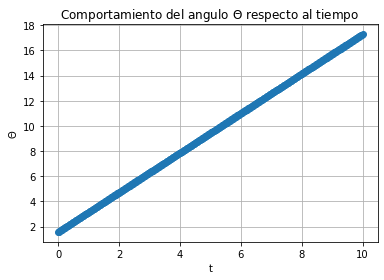

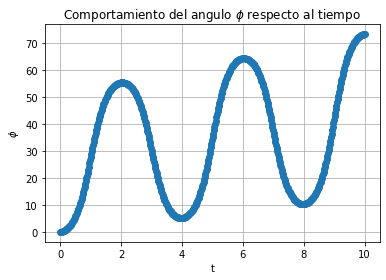

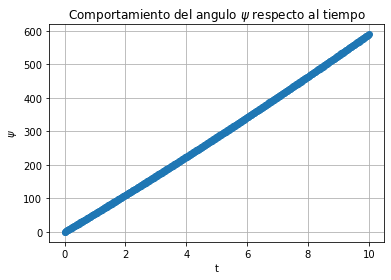

In [5]:
plt.title("Comportamiento del angulo $\Theta$ respecto al tiempo ")
plt.plot(t,theta,"-o")
plt.xlabel("t")
plt.ylabel("$\Theta$")
plt.grid()
plt.show()
plt.title("Comportamiento del angulo $\phi$ respecto al tiempo ")
plt.plot(t,phi,"-o")
plt.xlabel("t")
plt.ylabel("$\phi$")
plt.grid()
plt.show()
plt.title("Comportamiento del angulo $\psi$ respecto al tiempo ")
plt.plot(t,psi,"-o")
plt.xlabel("t")
plt.ylabel("$\psi$")
plt.grid()
plt.show()

En principio genera una cierta duda el resultado obtenido pero acordándonos de la explicación en [2] sobre como los resultados dependen de valores dados o que [3] se basa casi totalmente en 2 obtiene valeres parecidos pero aun así diferentes o que nuestro resultado en otra escala podría coincidir, principalmente el valor de $\psi$ se acomoda mejor con los resultados esperados mientras que el valor de $\phi$ parece distante, vemos que es un valor que oscila pero a la vez aumenta al igual que se ve en [2] y se ve como $\psi$ tiene una pendiente mayor que la de $\phi$, a gran escala podría esperarse que esa oscilación en $\phi$ se viera como una recta.

Animation size has reached 21001384 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


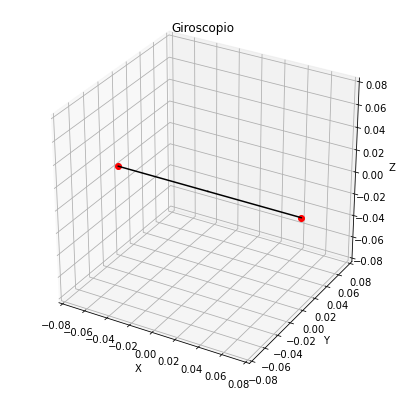

In [6]:
fig = plt.figure(figsize=(7, 7))
ax = fig.add_subplot(111, projection='3d')


CM1,= ax.plot([], [], [],"o",color="red")
CM2,= ax.plot([], [], [],"o",color="red")
O1,= ax.plot([], [], [],color="black")
O2,= ax.plot([], [], [],color="black")
        
def animate(a):
    x=h*np.sin(theta)*np.cos(phi)
    y=h*np.sin(theta)*np.sin(phi)
    z=h*np.cos(theta)
    CM1.set_data(x[a],y[a])
    CM1.set_3d_properties(z[a])
    O1.set_data([0,x[a]],[0,y[a]])
    O1.set_3d_properties([0,z[a]])
    CM2.set_data(-x[a],-y[a])
    CM2.set_3d_properties(-z[a])
    O2.set_data([0,-x[a]],[0,-y[a]])
    O2.set_3d_properties([0,-z[a]])

    
    return CM1,O1,CM2,O2

ax.set_title("Giroscopio")

ax.set_xlim3d([-0.08,0.08])
ax.set_xlabel('X')

ax.set_ylim3d([-0.08, 0.08])
ax.set_ylabel('Y')

ax.set_zlim3d([-0.08, 0.08])
ax.set_zlabel('Z')

ani = animation.FuncAnimation(fig, animate, np.arange(0, len(phi)),interval=len(t))
#ani.save('im.mp4', writer=writer)

HTML(ani.to_jshtml())

El primer resultado visto es algo raro de ver al inicio ya que puede parecer el movimiento esperado hay momentos en los que no parece dicho comportamiento, una de las principales causas es haber usado como valor inicial de $\dot{\theta}$ el obtenido al resolver la ecuación de $\ddot{\theta}$ en lugar de usar $\dot{\theta}=0$, cuando jugamos con dicho valor hallamos hallas un movimiento sobre el plano xy el cual no oscila sobre el, al aumentar dicho valor encontramos muchos tipos de movimientos diferentes en los cuales en algunos casos hallamos oscilaciones respecto a dicho plano un movimiento mientras que el plano de dicho movimiento va rotando, vemos que de todos estos valores el principal parámetro es el valor inicial de $\dot{\phi}$ del cual podemos obtener $\ddot{\theta}$. 

Lo interesante de este movimiento es ver la variación del angulo de nutación ($\theta$) y lo diferente que es el movimiento a lo esperado cuando $\dot{\theta}=0$ en especial en el punto que el giroscopio cambia el sentido del giro.

Del hecho que la rotación dada por $\phi$ es la del giro y por la consideraciones hechas esta es constante se ve muy visible que el cuerpo del extremo del giroscopio gira a una velocidad constante y el angulo aumenta linealmente(lo único obvio que vemos), como $\theta$ cambia linealmente en una escala de considerable se observa ese efecto raro en el movimiento que nos representa la nutación del sistema y es la responsable entre de efectos como ese cambio visto en la dirección del movimiento cosa que no vemos en casos en los que $\dot{\theta_0}=0$ y que cuando nos alejamos vemos que el cuerpo va cambiando la dirección del giro o el sentido. Por ultimo tenemos a la precesión descrita por el angulo $\phi$, de las gráficas anteriores vemos oscila pero no alrededor de un punto y que cada $\Delta t=2$ se encuentra un extremo en dicho angulo,y en principio difícil de notar aceptando ciertos puntos donde se hace mas notorio dicho movimiento.

## Bibliografía

[1]Introductory classical mechanics with problems and solutions, David Morin,cpitulos 8.7.5 y 8.7.6

[2]The analytical mechanics of the gyroscope in ECE2 theory, M. W. Evans y H. Eckardt

[3]El giróscopo comprendido íntegramente: Movimiento giroscópico completo con torque, traduccion hecha del trabajo anterior por Alex Hill

En la ultima se hallan algunos cambios lo cual permite ver un comportamiento algo diferente al igual que en nuestro trabajo.